## Plotly Case Study

#### Importing Required libraries

In [13]:
import pandas as pd

import plotly
import plotly.graph_objects as go
from plotly import graph_objs as go
from ipywidgets import widgets
from IPython.display import display
import plotly.express as px

plotly.offline.init_notebook_mode(connected= True)

from matplotlib import pyplot as plt
import seaborn as sns

#### Load the data

In [14]:
df= pd.read_csv('AB_NYC_2019.csv')
df.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,19-10-2018,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,21-05-2019,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,05-07-2019,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,19-11-2018,0.10,1,0


#### EDA

In [15]:
df.shape

(48895, 16)

In [16]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48895 entries, 0 to 48894
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              48895 non-null  int64  
 1   name                            48879 non-null  object 
 2   host_id                         48895 non-null  int64  
 3   host_name                       48874 non-null  object 
 4   neighbourhood_group             48895 non-null  object 
 5   neighbourhood                   48895 non-null  object 
 6   latitude                        48895 non-null  float64
 7   longitude                       48895 non-null  float64
 8   room_type                       48895 non-null  object 
 9   price                           48895 non-null  int64  
 10  minimum_nights                  48895 non-null  int64  
 11  number_of_reviews               48895 non-null  int64  
 12  last_review                     

In [17]:
df.describe()

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,4.889500e+04,4.889500e+04,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000,38843.000000,48895.000000,48895.000000
mean,1.901714e+07,6.762001e+07,40.728949,-73.952170,152.720687,7.029962,23.274466,1.373221,7.143982,112.781327
std,1.098311e+07,7.861097e+07,0.054530,0.046157,240.154170,20.510550,44.550582,1.680442,32.952519,131.622289
min,2.539000e+03,2.438000e+03,40.499790,-74.244420,0.000000,1.000000,0.000000,0.010000,1.000000,0.000000
25%,9.471945e+06,7.822033e+06,40.690100,-73.983070,69.000000,1.000000,1.000000,0.190000,1.000000,0.000000
50%,1.967728e+07,3.079382e+07,40.723070,-73.955680,106.000000,3.000000,5.000000,0.720000,1.000000,45.000000
75%,2.915218e+07,1.074344e+08,40.763115,-73.936275,175.000000,5.000000,24.000000,2.020000,2.000000,227.000000
max,3.648724e+07,2.743213e+08,40.913060,-73.712990,10000.000000,1250.000000,629.000000,58.500000,327.000000,365.000000


In [18]:
df.nunique()

id                                48895
name                              47896
host_id                           37457
host_name                         11452
neighbourhood_group                   5
neighbourhood                       221
latitude                          19048
longitude                         14718
room_type                             3
price                               674
minimum_nights                      109
number_of_reviews                   394
last_review                        1764
reviews_per_month                   937
calculated_host_listings_count       47
availability_365                    366
dtype: int64

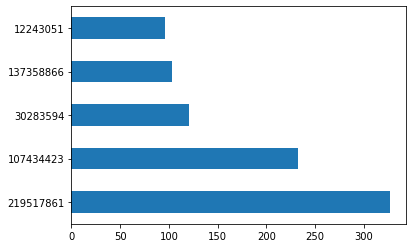

In [19]:
# host_id
# It's observed that a customer has transacted a maximum of 327 times in the year 2019.
# Host with id = 219517861 is the most popular host among customers with the most number of transactions.


df.host_id.value_counts().iloc[:5].plot(kind = 'barh')
plt.show()


#### Room Type Distributions

In [20]:
df_room_type= df[['room_type','id']].groupby(['room_type']).count().reset_index()

In [21]:
df_room_type

,room_type,id
0,Entire home/apt,25409
1,Private room,22326
2,Shared room,1160


In [22]:
df_room_type.columns= ['room_type','count']

df_room_type['percent']= (df_room_type['count']/df_room_type['count'].sum())*100

In [23]:
df_room_type

,room_type,count,percent
0,Entire home/apt,25409,51.966459
1,Private room,22326,45.661111
2,Shared room,1160,2.372431


In [24]:
px.pie(df, names = 'room_type', title='Customer Room Preference')

Contribution Room-Type of listing properties:
- Major part of the properties listed are either Entire home/apt (51.97%) or Private room (45.66%)
- Only 2.37% of listings is Shared Room

#### Neighbourhood Group Distribution

In [25]:
df_ne_grp= df[['neighbourhood_group','id']].groupby(['neighbourhood_group']).count().reset_index()
df_ne_grp.columns= ['neighbourhood_group','count']

df_ne_grp['percent']= (df_ne_grp['count']/df_ne_grp['count'].sum())*100

df_ne_grp

,neighbourhood_group,count,percent
0,Bronx,1091,2.231312
1,Brooklyn,20104,41.116679
2,Manhattan,21661,44.301053
3,Queens,5666,11.588097
4,Staten Island,373,0.762859


In [26]:
data= [go.Bar(
        x=df_ne_grp['neighbourhood_group'],
        y=df_ne_grp['percent']
)]

fig=go.Figure(data=data)
fig.update_layout(xaxis_title="Neighbourhood Group", yaxis_title= "Percent of Listings")
fig.show()

Manhattan(~44.3%) and Brooklyn(~41.1%), together has 85.4% of the listed properties.
Staten Island has less tha 1% of the listings.

This is because Manhattan and Brooklyn are the most developed part of NY City.

#### Room Type Contribution in Each Neighbouring groups

In [27]:
df_ne_rm_grp= df[['neighbourhood_group','room_type','id']].groupby(['neighbourhood_group','room_type']).count().reset_index()
df_ne_rm_grp.columns= ['neighbourhood_group','room_type','count_ng_rm']

df_ne_rm_grp= df_ne_rm_grp.merge(df_ne_grp[['neighbourhood_group','count']],how='inner',\
                                left_on='neighbourhood_group',right_on='neighbourhood_group')

df_ne_rm_grp['percent_grp']= (df_ne_rm_grp['count_ng_rm']/df_ne_rm_grp['count'])*100

df_ne_rm_grp

,neighbourhood_group,room_type,count_ng_rm,count,percent_grp
0,Bronx,Entire home/apt,379,1091,34.738772
1,Bronx,Private room,652,1091,59.761687
2,Bronx,Shared room,60,1091,5.499542
3,Brooklyn,Entire home/apt,9559,20104,47.547752
4,Brooklyn,Private room,10132,20104,50.397931
5,Brooklyn,Shared room,413,20104,2.054318
6,Manhattan,Entire home/apt,13199,21661,60.934398
7,Manhattan,Private room,7982,21661,36.849638
8,Manhattan,Shared room,480,21661,2.215964
9,Queens,Entire home/apt,2096,5666,36.992587


In [28]:
ne_grp = df_ne_rm_grp['neighbourhood_group'].unique()
print(ne_grp)

rm_grp = df_ne_rm_grp['room_type'].unique()
print(rm_grp)

['Bronx' 'Brooklyn' 'Manhattan' 'Queens' 'Staten Island']
['Entire home/apt' 'Private room' 'Shared room']


In [29]:
fig= go.Figure(data=[
    go.Bar(name=rm_grp[0], x=ne_grp, y=df_ne_rm_grp[df_ne_rm_grp['room_type'] == rm_grp[0]]['percent_grp']),
    go.Bar(name=rm_grp[1], x=ne_grp, y=df_ne_rm_grp[df_ne_rm_grp['room_type'] == rm_grp[1]]['percent_grp']),
    go.Bar(name=rm_grp[2], x=ne_grp, y=df_ne_rm_grp[df_ne_rm_grp['room_type'] == rm_grp[2]]['percent_grp']),
])

#Change the bar mode
fig.update_layout(barmode='stack', xaxis_title="Neighbourhood Group- Stacked with Room Type"\
                 , yaxis_title="Percent of Listings")
fig.show()

This shows that since Bronx is the least developed neighbourhood where the average salary of the people is less, shared room listing properties are more than any other neighbourhood groups. Where as in Manhattan listings of type entirehome/apt is more than others.

#### Distribution of Minimum Nights of stay

In [30]:
df['minimum_nights'].describe(percentiles = [0.25,0.35,0.40,0.50,0.75,0.80,0.9,0.99])

count    48895.000000
mean         7.029962
std         20.510550
min          1.000000
25%          1.000000
35%          2.000000
40%          2.000000
50%          3.000000
75%          5.000000
80%          6.000000
90%         28.000000
99%         45.000000
max       1250.000000
Name: minimum_nights, dtype: float64

In [31]:
data= [go.Histogram(
        x= df[df['minimum_nights']<=45]['minimum_nights'])]
fig= go.Figure(data)
fig.update_layout(xaxis_title= "Minimum nights of stay", yaxis_title= "Number of Listings")
fig.show()

The above histogram for minimum nights of stay shows most of the listings are booked for mostly 1 to 7 days, but we can see a strange spike in the number of listings when the minimum nights of stay is for 30days. So there are some listings in which minimum nights of stay is for 30 days(long stay properties). 

It's also interesting to note that around 3.8K people chose to stay for 30 minimum nights

Most of the listings do not have the minimum night criteria. 

#### Distribution of Calculated Host Listings count 

In [32]:
df['calculated_host_listings_count'].describe(percentiles = [0.50,0.75,0.80,0.9,0.94, 0.95,0.97,0.99])

count    48895.000000
mean         7.143982
std         32.952519
min          1.000000
50%          1.000000
75%          2.000000
80%          3.000000
90%          5.000000
94%         11.000000
95%         15.000000
97%         49.000000
99%        232.000000
max        327.000000
Name: calculated_host_listings_count, dtype: float64

In [33]:
data= [go.Histogram(
        x= df[df['calculated_host_listings_count']<=5]['calculated_host_listings_count'])]
fig= go.Figure(data)
fig.update_layout(xaxis_title= "Calculated Host Listings", yaxis_title= "Number of Listings")
fig.show()

Most of the host do not have multiple listings.

#### Distribution of price

In [34]:
df['price'].describe(percentiles = [0.25,0.35,0.40,0.50,0.75,0.80,0.9,0.99])

count    48895.000000
mean       152.720687
std        240.154170
min          0.000000
25%         69.000000
35%         81.000000
40%         90.000000
50%        106.000000
75%        175.000000
80%        200.000000
90%        269.000000
99%        799.000000
max      10000.000000
Name: price, dtype: float64

In [35]:
data= [go.Histogram(
        x= df[df['price']<=799]['price'], nbinsx=8)]
fig= go.Figure(data)
fig.update_layout(xaxis_title= "Price of listings", yaxis_title= "Number of Listings")
fig.show()

From the above histogram it can be seen that most of the listings are in the lower bucket range, very few listings are in the higher bucket range.

In [36]:
corr_cols= ['price','minimum_nights','number_of_reviews','reviews_per_month','calculated_host_listings_count',
            'availability_365']
df_corr= df[corr_cols]

px.parallel_coordinates(df_corr)

Here we can see that there are some listings which lets to stay for over a year or more, which has very less reviews i.e very less people visit these properties. Also these listings have very less prices.

#### Distribution of number of reviews using box plot

In [37]:
fig= go.Figure()
fig.add_trace(go.Box(y= df['number_of_reviews'], name= 'Number of Reviews', marker_color='green'))

fig.show()

The box plot is right skewed which means that most of the listings have average to low rating and very few of them have very high ratings.This explains that few listing properties have more bookings and so the number of reviews is more.

#### Distribution of Price using Box Plot

In [38]:
fig= go.Figure()
fig.add_trace(go.Box(y= df['price'], name= 'Price', marker_color='red'))

fig.show()

print(df.price.describe())

count    48895.000000
mean       152.720687
std        240.154170
min          0.000000
25%         69.000000
50%        106.000000
75%        175.000000
max      10000.000000
Name: price, dtype: float64


Most of the listings falls in the price range of 0 to 334, outside which there is skewness in the data.(right skew)

This tells that few listing properties have high prices which are basically the premium properties.

It can be seen that the rental for properties are priced at an average of 152 dollars. The most expensive AirBNB rental is 10K dollars whereas more than 50% of the listings are priced above 106 dollars

#### Price Vs Number of Review

In [39]:
fig= go.Figure()

fig.add_trace(go.Scatter(x=df['price'], y=df['number_of_reviews'], mode='markers', name='markers'))

fig.update_layout( title= "Price vs Number of Review",
                 xaxis_title="Price", yaxis_title="Number of Reviews", 
                 font=dict(family="Courier New, monospace", size=18,color="RebeccaPurple"))

fig.show()

The Scatter plot shows that properties with less price has more number of reviews which in turn means that there are more number of bookings for properties of higher prices.

#### Drop Down- Neighbourhood group price variations

In [40]:
#Initialise the figure
fig= go.Figure()

#Add Traces
fig.add_trace(
    go.Violin(y=list(df[df['neighbourhood_group'] == 'Brooklyn']['price'].reindex()),
             name= "Brooklyn",
             line= dict(color="blue")))

fig.add_trace(
    go.Violin(y=list(df[df['neighbourhood_group'] == 'Manhattan']['price'].reindex()),
             name= "Manhattan",
             line= dict(color="red")))

fig.add_trace(
    go.Violin(y=list(df[df['neighbourhood_group'] == 'Queens']['price'].reindex()),
             name= "Queens",
             line= dict(color="green")))

fig.add_trace(
    go.Violin(y=list(df[df['neighbourhood_group'] == 'Staten Island']['price'].reindex()),
             name= "Staten Island",
             line= dict(color="Purple")))

fig.add_trace(
    go.Violin(y=list(df[df['neighbourhood_group'] == 'Bronx']['price'].reindex()),
             name= "Bronx",
             line= dict(color="Orange")))

fig.update_layout(
    updatemenus= [
        dict(
            active=0,
            buttons=list([
                dict(label="All",
                    method="update",
                    args=[{"visible": [True,True,True,True,True]},
                         {"title": "Price Variations"}]),
                dict(label="Brooklyn",
                    method="update",
                    args=[{"visible": [True,False,False,False,False]},
                         {"title": "Brooklyn Price"}]),
                dict(label="Manhattan",
                    method="update",
                    args=[{"visible": [False,True,False,False,False]},
                         {"title": "Manhattan Price"}]),
                dict(label="Queens",
                    method="update",
                    args=[{"visible": [False,False,True,False,False]},
                         {"title": "Queens Price"}]),
                dict(label="Staten Island",
                    method="update",
                    args=[{"visible": [False,False,False,True,False]},
                         {"title": "Staten Island Price"}]),
                dict(label="Bronx",
                    method="update",
                    args=[{"visible": [False,False,False,False,True]},
                         {"title": "Bronx Price"}]),
            ]),
        )
    ])

#Set title and labels
fig.update_layout(title_text="Price Distribution by Neighbourhood Group", xaxis_title="Neighbourhood Group")

fig.show()

Manhattan has high value price properties (even the outside of the upper fence) listed compared to other neighbourhood groups

- The highest priced AirBNB's are in Brooklyn,, Manhattan, Queens
- Manhattan has an median price of 150 dollars whereas Brooklyn has an median price of 90 dollars.

#### Price Distribution by Room Type

In [41]:
fig= go.Figure()

df_room_type= df[df['price']<2000]

fig.add_trace(
    go.Box(y=list(df_room_type[df_room_type['room_type'] == 'Entire home/apt']['price'].reindex()),
          name= "Entire home/apt",
          line=dict(color= 'red')))

fig.add_trace(
    go.Box(y=list(df_room_type[df_room_type['room_type'] == 'Private room']['price'].reindex()),
          name= "Private room",
          line=dict(color= 'blue')))

fig.add_trace(
    go.Box(y=list(df_room_type[df_room_type['room_type'] == 'Shared room']['price'].reindex()),
          name= "Shared room",
          line=dict(color= 'green')))

fig.update_layout(
    updatemenus=[
        dict(
            active=0,
            buttons=list([
                dict(label="All",
                    method="update",
                    args=[{"visible": [True,True,True]},
                         {"title": "Price Variations- Room Type"}]),
                dict(label="Entire home/apt",
                    method="update",
                    args=[{"visible": [True,False,False]},
                         {"title": "Entire home/apt Price"}]),
                dict(label="Private room",
                    method="update",
                    args=[{"visible": [False,True,False]},
                         {"title": "Private room Price"}]),
                dict(label="Shared room",
                    method="update",
                    args=[{"visible": [False,False,True]},
                         {"title": "Shared room Price"}]),
            ]),
        )
    ])

#Set title and labels
fig.update_layout(title_text="Price Distribution by Room Type", xaxis_title="Room Type")

fig.show()

Entire home/apt price >> Private room >> Shared room price

In [42]:
fig = px.density_mapbox(df, lat='latitude', lon='longitude', z='price', radius=10,
                        center=dict(lat=40, lon=73), zoom=0,
                        mapbox_style="stamen-terrain")
fig.show()

Ot can be seen that the listing near to the rivers has higher prices.

In [60]:
# neighbourhood

print(df.neighbourhood.value_counts().iloc[:5])

px.bar(df.neighbourhood.value_counts().iloc[:5], title="Customer Preferred Areas",color_discrete_sequence =['green']*len(df)
)

Williamsburg          3920
Bedford-Stuyvesant    3714
Harlem                2658
Bushwick              2465
Upper West Side       1971
Name: neighbourhood, dtype: int64


It is clear that "Williamsburg", "Bedford-Stuyvesant" and "Bushwick" areas are most popular among customers in Brooklyn whereas "Harlem" and "Upper West Side" areas are popular among customers in Manhattan.

In [44]:
df2 = df.sort_values(by=['number_of_reviews'], ascending=False).head()
px.bar(data_frame=df2, x='name', y='number_of_reviews', hover_data = ['neighbourhood_group', 'neighbourhood', 'room_type', 
                                                                      'price', 'minimum_nights','availability_365'])


- Most popular listings are from Queens and Manhattan
- The "Room near JFK Queen Bed" is the most popular with 629 reviews and is situated in Queens
- The top 5 listings are priced below 50 dollars and are private rooms which are available almost through out the year

In [45]:
px.box(data_frame=df, x='neighbourhood_group',y='availability_365')

Staten Island has the highest average airBNB availability followed by Bronx.

In [46]:
# Rooms with top 100 reviews classified by neighbourhood

px.bar(data_frame = df.sort_values(by=['number_of_reviews'],ascending=False).head(100), x='neighbourhood_group', 
       title='Classification of Locations by Reviews')

After looking at the top 100 rows with highest number of reviews, we can see that Brooklyn has the highest reviews followed by Queens and Manhattan.

In [47]:
# top 100 Expensive rooms classified by neighbourhood

px.bar(data_frame = df.sort_values(by=['price'],ascending=False).head(100), x='neighbourhood_group', 
       title='Classification of Locations by Price')

After looking at the top 100 rows with highest price, we can see that Manhattan has the highest price followed by Brooklyn.

In [48]:
# Rooms with top 100 reviews classified by room_type

px.bar(data_frame = df.sort_values(by=['number_of_reviews'],ascending=False).head(100), x='room_type', 
       title='Classification of Room Types by Reviews')

After looking at the top 100 rows with highest number of reviews, we can see that Private_room has the highest reviews

In [49]:
# top 100 Expensive rooms classified by room_type

px.bar(data_frame = df.sort_values(by=['price'],ascending=False).head(100), x='room_type', 
       title='Classification of Room Types by Price')

After looking at the top 100 rows with highest price, we can see that Entire home/apt has the highest price

In [50]:
#df.sort_values(by=['number_of_reviews'])
df[df.availability_365 != 0].sort_values(by=['number_of_reviews']).head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
48894,36487245,Trendy duplex in the very heart of Hell's Kitchen,68119814,Christophe,Manhattan,Hell's Kitchen,40.76404,-73.98933,Private room,90,7,0,NaN,NaN,1,23
42641,33101073,Bright UES apt close to everything 24hr doorman,147827717,Julie,Manhattan,Upper East Side,40.76329,-73.96119,Private room,109,4,0,NaN,NaN,1,101
12592,9679935,"Wyndham Resort Midtown 45 NYC Studio Sep 1-4, ...",24199235,Dar,Manhattan,Midtown,40.75328,-73.97212,Private room,224,3,0,NaN,NaN,1,3
42644,33107400,"Wonderful 3 people room near M,J, L,G trains",248161322,Sergii,Brooklyn,Bushwick,40.70028,-73.93952,Shared room,35,30,0,NaN,NaN,14,333
42645,33107548,NYUW05-2: Centra Park one bedroom by river,39890192,Laura,Manhattan,Upper West Side,40.80319,-73.96676,Private room,70,15,0,NaN,NaN,12,153


Comparing with the one's which are more popular, we see that 
- the price range is very high ... popular listings had a price that doesn't exceed 50 dollars.
- minimum nights requirement is high when compared to the popular listing where the min_nights req is 1
- the availability is less